##### Importing libraries

In [26]:
# Required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import statistics
import statsmodels.api as sm
# mlxtend --no-deps

# Scikit-Learn models, metrics, preprocessing
from sklearn.model_selection import train_test_split,cross_val_score, GridSearchCV
from sklearn.preprocessing import LabelEncoder,StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
from sklearn.metrics import mean_squared_error, r2_score,mean_absolute_error

# Importing plotly visualization library
import plotly.express as px
import plotly.figure_factory as ff

#Filter and ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [27]:
# Load & Understand df
df = pd.read_csv("../dataset/raw_data.csv")
df.head()                             # Printing top 5 rows of df dataframe

,ID,Delivery_person_ID,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Orderd,Time_Order_picked,Weatherconditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City_type,Time_taken(min)
0,0x4607,INDORES13DEL02,37,4.9,22.745049,75.892471,22.765049,75.912471,19-03-2022,11:30:00,11:45:00,conditions Sunny,High,2,Snack,motorcycle,0,No,Urban,(min) 24
1,0xb379,BANGRES18DEL02,34,4.5,12.913041,77.683237,13.043041,77.813237,25-03-2022,19:45:00,19:50:00,conditions Stormy,Jam,2,Snack,scooter,1,No,Metropolitian,(min) 33
2,0x5d6d,BANGRES19DEL01,23,4.4,12.914264,77.678400,12.924264,77.688400,19-03-2022,08:30:00,08:45:00,conditions Sandstorms,Low,0,Drinks,motorcycle,1,No,Urban,(min) 26
3,0x7a6a,COIMBRES13DEL02,38,4.7,11.003669,76.976494,11.053669,77.026494,05-04-2022,18:00:00,18:10:00,conditions Sunny,Medium,0,Buffet,motorcycle,1,No,Metropolitian,(min) 21
4,0x70a2,CHENRES12DEL01,32,4.6,12.972793,80.249982,13.012793,80.289982,26-03-2022,13:30:00,13:45:00,conditions Cloudy,High,1,Snack,scooter,1,No,Metropolitian,(min) 30


In [28]:
# Columns of dataframe
# Target variable (y) is Time_taken(min), also called predicted variable
# Drop Time_taken(min) from df as it is target variable
df.columns

Index(['ID', 'Delivery_person_ID', 'Delivery_person_Age',
       'Delivery_person_Ratings', 'Restaurant_latitude',
       'Restaurant_longitude', 'Delivery_location_latitude',
       'Delivery_location_longitude', 'Order_Date', 'Time_Orderd',
       'Time_Order_picked', 'Weatherconditions', 'Road_traffic_density',
       'Vehicle_condition', 'Type_of_order', 'Type_of_vehicle',
       'multiple_deliveries', 'Festival', 'City_type', 'Time_taken(min)'],
      dtype='object')

In [29]:
# Dimensions of the dataframe
print("Train Dataset :", df.shape)

Train Dataset : (45593, 20)


In [30]:
# Finding datatype of each column in dataframe
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45593 entries, 0 to 45592
Data columns (total 20 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   ID                           45593 non-null  object 
 1   Delivery_person_ID           45593 non-null  object 
 2   Delivery_person_Age          45593 non-null  object 
 3   Delivery_person_Ratings      45593 non-null  object 
 4   Restaurant_latitude          45593 non-null  float64
 5   Restaurant_longitude         45593 non-null  float64
 6   Delivery_location_latitude   45593 non-null  float64
 7   Delivery_location_longitude  45593 non-null  float64
 8   Order_Date                   45593 non-null  object 
 9   Time_Orderd                  45593 non-null  object 
 10  Time_Order_picked            45593 non-null  object 
 11  Weatherconditions            45593 non-null  object 
 12  Road_traffic_density         45593 non-null  object 
 13  Vehicle_conditio

##### Summary statistics of numeric and non-numeric fields

In [31]:
#Check statistical values for fields with numerical datatype
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Restaurant_latitude,45593.0,17.017729,8.185109,-30.905562,12.933284,18.546947,22.728163,30.914057
Restaurant_longitude,45593.0,70.231332,22.883647,-88.366217,73.170000,75.898497,78.044095,88.433452
Delivery_location_latitude,45593.0,17.465186,7.335122,0.010000,12.988453,18.633934,22.785049,31.054057
Delivery_location_longitude,45593.0,70.845702,21.118812,0.010000,73.280000,76.002574,78.107044,88.563452
Vehicle_condition,45593.0,1.023359,0.839065,0.000000,0.000000,1.000000,2.000000,3.000000


In [32]:
#Check statistical values for fields with other than numerical datatype
df.describe(exclude=np.number).T

,count,unique,top,freq
ID,45593,45593,0x4607,1
Delivery_person_ID,45593,1320,PUNERES01DEL01,67
Delivery_person_Age,45593,23,35,2262
Delivery_person_Ratings,45593,29,4.8,7148
Order_Date,45593,44,15-03-2022,1192
Time_Orderd,45593,177,NaN,1731
Time_Order_picked,45593,193,21:30:00,496
Weatherconditions,45593,7,conditions Fog,7654
Road_traffic_density,45593,5,Low,15477
Type_of_order,45593,4,Snack,11533


**Observations:**
* There are null values present in Time_Orderd column. String "Nan" value.
* Cannot directly do impute as it is "hh:mm:ss" format.
* Difference of time_ordered and order_picked gives food_preparation_time.
* Median of the food_preparation_time used as snacks require less time to make, other foods like buffet and meals takes more time.

1. Data Formatting will be required for Weatherconditions & Time_taken(min) column.
2. Both numerical & categorical features are present.
3. ID & Delivery_person_ID will not be used to build the model.

##### **Data Cleaning**

In [33]:
# Update Column Names
def update_column_name(df):
    # Renaming Weatherconditions column
    df.rename(columns={'Weatherconditions': 'Weather_conditions'},inplace=True)

update_column_name(df)
print(df.columns)

Index(['ID', 'Delivery_person_ID', 'Delivery_person_Age',
       'Delivery_person_Ratings', 'Restaurant_latitude',
       'Restaurant_longitude', 'Delivery_location_latitude',
       'Delivery_location_longitude', 'Order_Date', 'Time_Orderd',
       'Time_Order_picked', 'Weather_conditions', 'Road_traffic_density',
       'Vehicle_condition', 'Type_of_order', 'Type_of_vehicle',
       'multiple_deliveries', 'Festival', 'City_type', 'Time_taken(min)'],
      dtype='object')


In [34]:
#Extract relevant values from column

def extract_column_value(df):
    '''
    Remove "min" string from target variable and get numerical target
    '''
    # Extract time and convert to int
    df['Time_taken(min)'] = df['Time_taken(min)'].apply(lambda x: int(x.split(' ')[1].strip()))


    # Extract Weather conditions
    df['Weather_conditions'] = df['Weather_conditions'].apply(lambda x: x.split(' ')[1].strip())

    # Extract city code from Delivery person ID
    df['City_code'] = df['Delivery_person_ID'].str.split("RES", expand=True)[0]

extract_column_value(df)
df[['Time_taken(min)','Weather_conditions','City_code']].head()

,Time_taken(min),Weather_conditions,City_code
0,24,Sunny,INDO
1,33,Stormy,BANG
2,26,Sandstorms,BANG
3,21,Sunny,COIMB
4,30,Cloudy,CHEN


In [35]:
# Unique values of some categorical columns of df
columns = ['Weather_conditions', 'Road_traffic_density',
       'Vehicle_condition', 'Type_of_order', 'Type_of_vehicle',
      'multiple_deliveries', 'Festival', 'City_type']

for column in columns:
    unique_values = df[column].unique().tolist()
    print(column, ":", unique_values)

Weather_conditions : ['Sunny', 'Stormy', 'Sandstorms', 'Cloudy', 'Fog', 'Windy', 'NaN']
Road_traffic_density : ['High ', 'Jam ', 'Low ', 'Medium ', 'NaN ']
Vehicle_condition : [2, 0, 1, 3]
Type_of_order : ['Snack ', 'Drinks ', 'Buffet ', 'Meal ']
Type_of_vehicle : ['motorcycle ', 'scooter ', 'electric_scooter ', 'bicycle ']
multiple_deliveries : ['0', '1', '3', 'NaN ', '2']
Festival : ['No ', 'Yes ', 'NaN ']
City_type : ['Urban ', 'Metropolitian ', 'Semi-Urban ', 'NaN ']


In [36]:
# Drop Columns which won't be use for building model
def drop_columns(df):
    df.drop(['ID','Delivery_person_ID'],axis=1,inplace=True)

print("Before No. of columns: ",df.shape[1])
drop_columns(df)
print("After No. of columns: ",df.shape[1])

#Check for Duplicate Values
if (len(df[df.duplicated()])>0):
    print("\nThere are Duplicate values present")
else:
    print("\nThere is no duplicate value present")

Before No. of columns:  21
After No. of columns:  19

There is no duplicate value present


In [37]:
# Update datatypes
def update_datatype(df):
    df['Delivery_person_Age'] = df['Delivery_person_Age'].astype('float64')
    df['Delivery_person_Ratings'] = df['Delivery_person_Ratings'].astype('float64')
    df['multiple_deliveries'] = df['multiple_deliveries'].astype('float64')
    df['Order_Date']=pd.to_datetime(df['Order_Date'],format="%d-%m-%Y")

update_datatype(df)

In [38]:
#Convert String 'NaN' to np.nan
'''
It seems "NaN" strings have a space after them, convert both "NaN " and "NaN" to object Null values
So, we use regex approach.
'''

def convert_nan(df):
    df.replace('NaN', float(np.nan), regex=True,inplace=True)

convert_nan(df)

In [39]:
#Check null values
df.isnull().sum().sort_values(ascending=False)

Delivery_person_Ratings        1908
Delivery_person_Age            1854
Time_Orderd                    1731
City_type                      1200
multiple_deliveries             993
Weather_conditions              616
Road_traffic_density            601
Festival                        228
Order_Date                        0
Delivery_location_longitude       0
Time_Order_picked                 0
Delivery_location_latitude        0
Vehicle_condition                 0
Type_of_order                     0
Type_of_vehicle                   0
Restaurant_longitude              0
Restaurant_latitude               0
Time_taken(min)                   0
City_code                         0
dtype: int64

##### **Analysis and explore data**

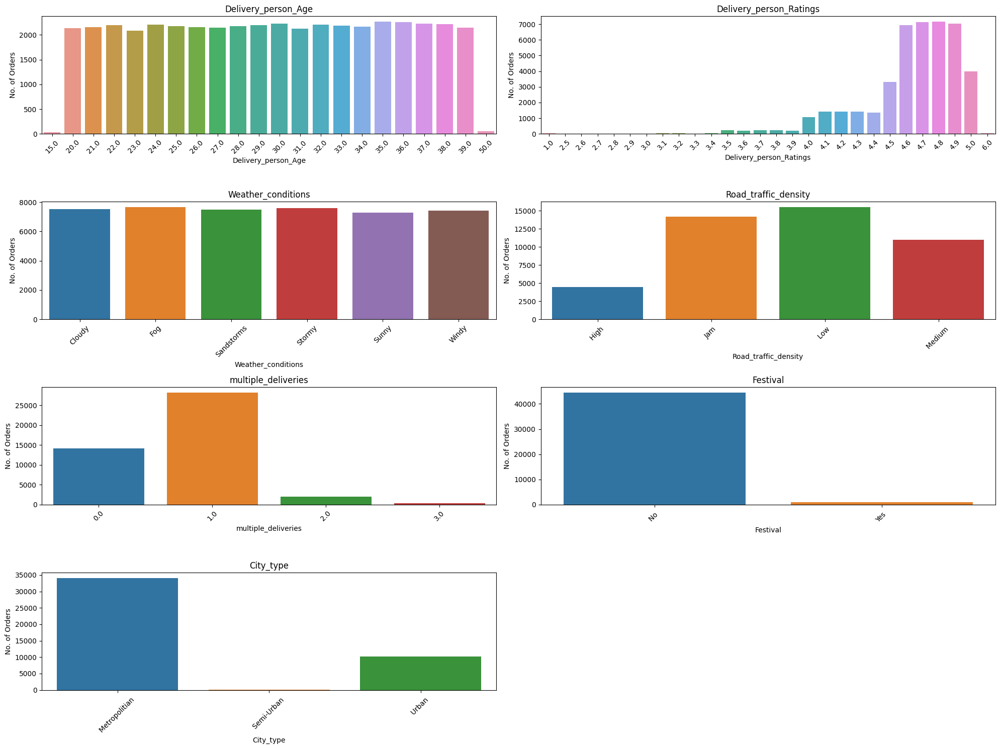

In [40]:
#Let's explore columns that have null values
cols = ['Delivery_person_Age','Delivery_person_Ratings','Weather_conditions','Road_traffic_density','multiple_deliveries','Festival','City_type']
num_plots = len(cols)
num_rows = (num_plots // 2) + (num_plots % 2)

fig, axes = plt.subplots(num_rows, 2, figsize=(20,15))

for i, column_name in enumerate(cols):
    row = i // 2
    col = i % 2

    ax = axes[row, col]
    sns.countplot(data=df, x=column_name, order=df[column_name].value_counts().sort_index().index, ax=ax)

    ax.set_xlabel(column_name)
    ax.set_ylabel('No. of Orders')
    ax.set_title(column_name)
    ax.tick_params(axis='x', rotation=45)

if num_plots % 2 != 0:
    fig.delaxes(axes[-1, -1])

plt.tight_layout()
plt.show()

**Bar plots of categorical columns**

'Delivery_person_Age', 'Delivery_person_Ratings', 'Weather_conditions', 'Road_traffic_density', 'multiple_deliveries', 'Festival', 'City'

with respect to number of orders.

In [41]:
from sklearn.impute import SimpleImputer
# Handle null values
def handle_null_values(df):
    df['Delivery_person_Age'].fillna(np.random.choice(df['Delivery_person_Age']), inplace=True)    # Names chosen randomly
    df['Weather_conditions'].fillna(np.random.choice(df['Weather_conditions']), inplace=True)      # weather chosen randomly

    mode_imp = SimpleImputer(missing_values=np.nan, strategy='most_frequent')                      # Filled with the most common value
    mode_cols = ["Road_traffic_density",
             "multiple_deliveries", "Festival", "City_type"]

    for col in mode_cols:
        df[col] = mode_imp.fit_transform(df[col].to_numpy().reshape(-1,1)).ravel()

    # Mean is affected by extreme values, mode gives highest frequency which is inappropriate
    # So, median is appropriate measure for imputing
    df['Delivery_person_Ratings'].fillna(df['Delivery_person_Ratings'].median(), inplace=True)

    df["Time_Orderd"] = df["Time_Orderd"].fillna(df["Time_Order_picked"])

handle_null_values(df)
df.isnull().sum()

Delivery_person_Age            0
Delivery_person_Ratings        0
Restaurant_latitude            0
Restaurant_longitude           0
Delivery_location_latitude     0
Delivery_location_longitude    0
Order_Date                     0
Time_Orderd                    0
Time_Order_picked              0
Weather_conditions             0
Road_traffic_density           0
Vehicle_condition              0
Type_of_order                  0
Type_of_vehicle                0
multiple_deliveries            0
Festival                       0
City_type                      0
Time_taken(min)                0
City_code                      0
dtype: int64

##### **Feature Engineering**

Creating new features from Order_date to enhance model performance

In [42]:
def extract_date_features(data):

    '''
    Create date intervals as; is weekend or not, periods of month and quarters of year
    '''

    # data['day_of_week'] = data.Order_Date.dt.day_of_week.astype(int)
    # data['is_weekend'] = np.where(data['day_of_week'].isin([5,6]),1,0)
    data["is_weekend"] = data["Order_Date"].dt.day_of_week > 4

    data["month_intervals"] = data["Order_Date"].apply(lambda x: "start_month" if x.day <=10
                                                   else ("middle_month" if x.day <= 20 else "end_month"))

    data["year_quarter"] = data["Order_Date"].apply(lambda x: x.quarter)

extract_date_features(df)
df.head()

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Orderd,Time_Order_picked,Weather_conditions,...,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City_type,Time_taken(min),City_code,is_weekend,month_intervals,year_quarter
0,37.0,4.9,22.745049,75.892471,22.765049,75.912471,2022-03-19,11:30:00,11:45:00,Sunny,...,Snack,motorcycle,0.0,No,Urban,24,INDO,True,middle_month,1
1,34.0,4.5,12.913041,77.683237,13.043041,77.813237,2022-03-25,19:45:00,19:50:00,Stormy,...,Snack,scooter,1.0,No,Metropolitian,33,BANG,False,end_month,1
2,23.0,4.4,12.914264,77.678400,12.924264,77.688400,2022-03-19,08:30:00,08:45:00,Sandstorms,...,Drinks,motorcycle,1.0,No,Urban,26,BANG,True,middle_month,1
3,38.0,4.7,11.003669,76.976494,11.053669,77.026494,2022-04-05,18:00:00,18:10:00,Sunny,...,Buffet,motorcycle,1.0,No,Metropolitian,21,COIMB,False,start_month,2
4,32.0,4.6,12.972793,80.249982,13.012793,80.289982,2022-03-26,13:30:00,13:45:00,Cloudy,...,Snack,scooter,1.0,No,Metropolitian,30,CHEN,True,end_month,1


In [43]:
# Find the difference between ordered time & picked time

def calculate_time_diff(df):
    # Convert time columns to timedelta
    df['Time_Orderd'] = pd.to_timedelta(df['Time_Orderd'])
    df['Time_Order_picked'] = pd.to_timedelta(df['Time_Order_picked'])

    # Calculate formatted pickup time considering cases where pickup time is on the next day
    df['Time_Order_picked_formatted'] = df['Order_Date'] + pd.to_timedelta(np.where(df['Time_Order_picked'] < df['Time_Orderd'], 1, 0), unit='D') + df['Time_Order_picked']

    # Calculate formatted order time
    df['Time_Ordered_formatted'] = df['Order_Date'] + df['Time_Orderd']

    # Calculate time difference in minutes
    df['order_prepare_time'] = (df['Time_Order_picked_formatted'] - df['Time_Ordered_formatted']).dt.total_seconds() / 60

    # Handle null values by filling with the median
    df['order_prepare_time'].fillna(df['order_prepare_time'].median(), inplace=True)

    # Drop all the time & date related columns
    df.drop(['Time_Orderd', 'Time_Order_picked', 'Time_Ordered_formatted', 'Time_Order_picked_formatted', 'Order_Date'], axis=1, inplace=True)

# df is DataFrame
calculate_time_diff(df)
df.head()

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Weather_conditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City_type,Time_taken(min),City_code,is_weekend,month_intervals,year_quarter,order_prepare_time
0,37.0,4.9,22.745049,75.892471,22.765049,75.912471,Sunny,High,2,Snack,motorcycle,0.0,No,Urban,24,INDO,True,middle_month,1,15.0
1,34.0,4.5,12.913041,77.683237,13.043041,77.813237,Stormy,Jam,2,Snack,scooter,1.0,No,Metropolitian,33,BANG,False,end_month,1,5.0
2,23.0,4.4,12.914264,77.678400,12.924264,77.688400,Sandstorms,Low,0,Drinks,motorcycle,1.0,No,Urban,26,BANG,True,middle_month,1,15.0
3,38.0,4.7,11.003669,76.976494,11.053669,77.026494,Sunny,Medium,0,Buffet,motorcycle,1.0,No,Metropolitian,21,COIMB,False,start_month,2,10.0
4,32.0,4.6,12.972793,80.249982,13.012793,80.289982,Cloudy,High,1,Snack,scooter,1.0,No,Metropolitian,30,CHEN,True,end_month,1,15.0


<font size="3">The Haversine formula is used to find the distance between two geographical locations.

Calculating the distance between restaurant and delivery locations.</font>

<font size="2">The formula is as follows:

Link: https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise.haversine_distances.html</font>

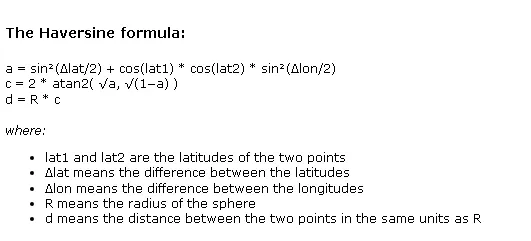

<font size="2">It takes the latitude and longitude of two points and converts the angles to radians to perform the necessary calculations. We use this formula because the dataset doesn’t provide the distance between the restaurant and the delivery location.</font>

<font size = "2">There are only latitude and longitude. So, let’s calculate it and then create a distance column in the dataset.</font>

In [44]:
R = 6371  ##The earth's radius (in km)

def deg_to_rad(degrees):
    return degrees * (np.pi/180)

## The haversine formula
def distcalculate(lat1, lon1, lat2, lon2):
    d_lat = deg_to_rad(lat2-lat1)
    d_lon = deg_to_rad(lon2-lon1)
    a1 = np.sin(d_lat/2)**2 + np.cos(deg_to_rad(lat1))
    a2 = np.cos(deg_to_rad(lat2)) * np.sin(d_lon/2)**2
    a = a1 * a2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))
    return R * c

# Create distance column & calculate the distance
df['distance'] = np.nan

for i in range(len(df)):
  df.loc[i, 'distance'] = distcalculate(df.loc[i, 'Restaurant_latitude'],
                                          df.loc[i, 'Restaurant_longitude'],
                                          df.loc[i, 'Delivery_location_latitude'],
                                          df.loc[i, 'Delivery_location_longitude'])
df.distance = df.distance.astype("int64")
df.distance.head()

0     2
1    14
2     1
3     5
4     4
Name: distance, dtype: int64

**The distance is in kilometers (km).**

##### **More exploratory data analyses**

In [45]:
# Plot 1
figure = px.scatter(data_frame = df,
                    x="distance",
                    y="Time_taken(min)",
                    size="Time_taken(min)",
                    trendline="ols",
                    title = "Relationship Between Time Taken and Distance")
figure.show()

**Effect of distance on the delivery time?**

The graph shows that there is a consistent relationship between the time taken and the distance traveled for food delivery. This means that the majority of delivery partners deliver food within a range of 25–30 minutes, regardless of the distance.


In [46]:
# Plot 2
figure = px.scatter(data_frame = df,
                    x="Delivery_person_Age",
                    y="Time_taken(min)",
                    size="Time_taken(min)",
                    color = "distance",
                    trendline="ols",
                    title = "Relationship Between Delivery Partner Age and Time Taken")
figure.show()

**Is delivery partner’s age affecting delivery time or not?**

The graph shows faster food delivery when partners are younger than their older counterparts.

In [47]:
figure = px.scatter(data_frame = df,
                    x="Delivery_person_Ratings",
                    y="Time_taken(min)",
                    size="Time_taken(min)",
                    color = "distance",
                    trendline="ols",
                    title = "Relationship Between Delivery Partner Ratings and Time Taken")
figure.show()

##### **Is there any correlation between delivery time and delivery partner ratings?**

The graph shows an inverse linear relationship. The higher the rating partner, the faster the time needed to deliver food, and vice versa.

In [48]:
fig = px.box(df,
             x="Type_of_vehicle",
             y="Time_taken(min)",
             color="Type_of_order",
             title = "Relationship Between Type of Vehicle and Type of Order")
fig.show()

##### **The delivery partner’s vehicle affects the delivery time or not?**

The graph shows that the type of delivery partner’s vehicle and the type of food delivered do not significantly affect delivery time.

**Through the analysis above, we can determine that the delivery partner’s age, the delivery partner’s rating, and the distance between the restaurant and the delivery location are the features that have the most significant impact on food delivery time.**

##### **Data Preprocessing**

##### Label Encoding

In [49]:
def label_encoding(df):
    categorical_columns = df.select_dtypes(include='object').columns
    label_encoder = LabelEncoder()
    df[categorical_columns] = df[categorical_columns].apply(lambda col: label_encoder.fit_transform(col))

label_encoding(df)
df.head()

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Weather_conditions,Road_traffic_density,Vehicle_condition,Type_of_order,...,multiple_deliveries,Festival,City_type,Time_taken(min),City_code,is_weekend,month_intervals,year_quarter,order_prepare_time,distance
0,37.0,4.9,22.745049,75.892471,22.765049,75.912471,4,0,2,3,...,0.0,0,2,24,10,True,1,1,15.0,2
1,34.0,4.5,12.913041,77.683237,13.043041,77.813237,3,1,2,3,...,1.0,0,0,33,3,False,0,1,5.0,14
2,23.0,4.4,12.914264,77.678400,12.924264,77.688400,2,2,0,1,...,1.0,0,2,26,3,True,1,1,15.0,1
3,38.0,4.7,11.003669,76.976494,11.053669,77.026494,4,3,0,0,...,1.0,0,0,21,6,False,2,2,10.0,5
4,32.0,4.6,12.972793,80.249982,13.012793,80.289982,0,0,1,3,...,1.0,0,0,30,5,True,0,1,15.0,4


In [50]:
df.columns

Index(['Delivery_person_Age', 'Delivery_person_Ratings', 'Restaurant_latitude',
       'Restaurant_longitude', 'Delivery_location_latitude',
       'Delivery_location_longitude', 'Weather_conditions',
       'Road_traffic_density', 'Vehicle_condition', 'Type_of_order',
       'Type_of_vehicle', 'multiple_deliveries', 'Festival', 'City_type',
       'Time_taken(min)', 'City_code', 'is_weekend', 'month_intervals',
       'year_quarter', 'order_prepare_time', 'distance'],
      dtype='object')

**To see the column indices in RFE, FFS**

In [51]:
column_mapping = {column_name: idx for idx, column_name in enumerate(df.columns)}
column_mapping

{'Delivery_person_Age': 0,
 'Delivery_person_Ratings': 1,
 'Restaurant_latitude': 2,
 'Restaurant_longitude': 3,
 'Delivery_location_latitude': 4,
 'Delivery_location_longitude': 5,
 'Weather_conditions': 6,
 'Road_traffic_density': 7,
 'Vehicle_condition': 8,
 'Type_of_order': 9,
 'Type_of_vehicle': 10,
 'multiple_deliveries': 11,
 'Festival': 12,
 'City_type': 13,
 'Time_taken(min)': 14,
 'City_code': 15,
 'is_weekend': 16,
 'month_intervals': 17,
 'year_quarter': 18,
 'order_prepare_time': 19,
 'distance': 20}

##### **Train Test split**

In [52]:
#Split features & label
X = df.drop('Time_taken(min)', axis=1)  # Features
y = df['Time_taken(min)']               # Target variable

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(36474, 20)
(36474,)
(9119, 20)
(9119,)


##### **Standardization**

In [53]:
# Create a StandardScaler object
scaler = StandardScaler()

# Fit the scaler on the training data
scaler.fit(X_train)

# Perform standardization on the training data
X_train = scaler.transform(X_train)

# Perform standardization on the testing data
X_test = scaler.transform(X_test)

##### **Model Building**
##### Steps

1. Employ cross-validation & hyper parameter tuning to determine the optimal regression model.
2. Construct the food delivery prediction model using the identified best model.
3. Evaluate the model's performance on the testing data to assess its accuracy and reliability.

##### Cross Validation

**Defining a parameter grid for hyperparameter tuning** for various machine learning models. Each dictionary within the `param_grid` list represents a set of hyperparameters to be tuned for a specific model.

**Hyperparameter tuning** involves searching for the optimal combination of hyperparameters to maximize model performance. By trying different combinations of hyperparameters, we can assess how each set of parameters affects the model's accuracy.

Techniques like grid search or randomized search are used to explore the parameter grid and find the best combination of hyperparameters that maximizes the model's performance.

Once you've defined your `param_grid`, we can pass it to a grid search or randomized search algorithm along with your model and training data to perform hyperparameter tuning.

We are using **GridSearchCV** for cross validation:

Here's a brief explanation of each set of hyperparameters in your `param_grid`:

1. Default parameters: Represents the default hyperparameters for the model.
2. `max_depth`: Varies the maximum depth of the decision trees in the model.
3. `n_estimators` and `max_features`: Varies the number of estimators (trees) and the maximum number of features to consider when splitting a node in the random forest model.
4. `n_estimators` and `max_depth`: Varies the number of estimators (trees) and the maximum depth of the trees in the XGBoost model.

In [54]:
# Find the best model
models = [
    LinearRegression(),
    DecisionTreeRegressor(),
    RandomForestRegressor(),
    xgb.XGBRegressor(),         # Random Forest regressor with XGBoost (Gradient Boosting Trees)

    # optional
    # LGBMRegressor(),          # Light Gradient Boost Regressor
    # CatBoostRegressor()       # Cat Boost Regressor
]

param_grid = [
    {},
    {'max_depth': [3, 5, 7]},
    {'n_estimators': [3, 5, 7], 'max_features': ['auto', 'sqrt', 'log2']},                          # to reduce training time
                                                                                                    # {'n_estimators': [100, 200, 300]}, # more training time

    {'n_estimators': [20, 25, 30], 'max_depth': [5, 7, 9]},                                         # xgb params

    # {'num_leaves': [15, 20, 5], 'max_depth': [3, 5, 8], 'learning_rate': [0.05, 0.1, 0.2]},       # 'num_leaves': [85]
    # {'n_estimators': [5, 7, 9], 'max_depth': [6, 8, 10], 'learning_rate': [0.05, 0.1, 0.2]}       # experiment with 'n_estimators': [500, 700, 900]
]

for i, model in enumerate(models):
    grid_search = GridSearchCV(model, param_grid[i], cv=5, scoring='r2')
    grid_search.fit(X_train, y_train)

    print(f"{model.__class__.__name__}:")
    print("Best parameters:", grid_search.best_params_)
    print("Best R2 score:", grid_search.best_score_)
    print()

LinearRegression:
Best parameters: {}
Best R2 score: 0.4188905345412353



DecisionTreeRegressor:
Best parameters: {'max_depth': 7}
Best R2 score: 0.7307579373386995

RandomForestRegressor:
Best parameters: {'max_features': 'auto', 'n_estimators': 7}
Best R2 score: 0.7891278800400764

XGBRegressor:
Best parameters: {'max_depth': 9, 'n_estimators': 20}
Best R2 score: 0.8198074395122207



##### **Fitting the model**

In [55]:
# Create a XGB regressor model
xgb_model = xgb.XGBRegressor(n_estimators=20,max_depth=9)

# Fit the model on the training data
xgb_model.fit(X_train, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=9, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=20, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, ...)

##### **Model Evaluation**

To calculate the adjusted R-squared, you can use the following formula:

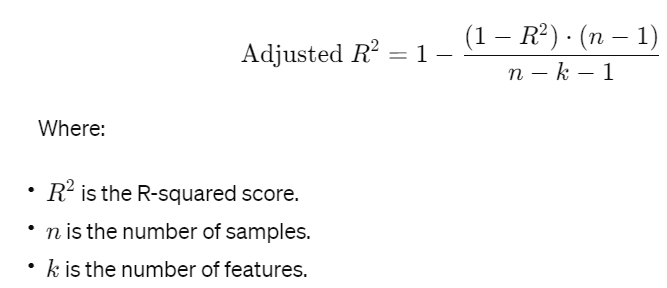

In [56]:
# Make predictions on the test data
y_pred = xgb_model.predict(X_test)

def adjusted_r_squared(r2, n, k):
    return 1 - ((1 - r2) * (n - 1) / (n - k - 1))

# Evaluate the model
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)
adjusted_r2 = adjusted_r_squared(r2, len(y_test), X_test.shape[1])

print("Mean Absolute Error (MAE):", round(mae,2))
print("Mean Squared Error (MSE):", round(mse,2))
print("Root Mean Squared Error (RMSE):", round(rmse,2))
print("R-squared (R2) Score:", round(r2,2))
print("Adjusted R-squared Score:", round(adjusted_r2, 2))

Mean Absolute Error (MAE): 3.15
Mean Squared Error (MSE): 15.7
Root Mean Squared Error (RMSE): 3.96
R-squared (R2) Score: 0.82
Adjusted R-squared Score: 0.82


##### **Feature Selection of training data**

**Forward Feature Selection** is an iterative method wherein we start with the performing features against the target features. Next, we select another variable that gives the best performance in combination with the first selected variable. This process continues until the preset criterion is achieved.

https://www.analyticsvidhya.com/blog/2020/10/feature-selection-techniques-in-machine-learning/

In [57]:
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
sfs = SFS(xgb.XGBRegressor(n_estimators=20,max_depth=9),
           k_features="best",
           forward=True,
           floating=False,
           verbose=2,
           scoring='r2',
           cv=2)

sfs = sfs.fit(X_train ,y_train)
selected_feat_= list(sfs.k_feature_names_)
selected_feat_ = list(map(int, selected_feat_))

selected_feat_

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    2.3s finished

[2024-03-31 17:34:29] Features: 1/20 -- score: 0.19198440188983829[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  19 out of  19 | elapsed:    3.5s finished

[2024-03-31 17:34:32] Features: 2/20 -- score: 0.34439291232674424[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  18 out of  18 | elapsed:    4.8s finished

[2024-03-31 17:34:37] Features: 3/20 -- score: 0.4610604229637437[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done

[0, 1, 6, 7, 8, 11, 12, 13, 15, 19]

The features selected are indexed at [0, 1, 6, 7, 8, 10, 11, 12, 13, 18, 19].

The features selected might vary a little, but the accuracy remains the same approximately.

In [58]:
# Split features and target variable

selected_columns = ['Delivery_person_Age', 'Delivery_person_Ratings', 'Weather_conditions',
                    'Road_traffic_density', 'Vehicle_condition', 'Type_of_vehicle', 'multiple_deliveries', 'Festival', 'City_type',
                    'month_intervals', 'year_quarter'
                    ]
X_train = df[selected_columns]         # Features
y = df['Time_taken(min)']              # Target variable

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


scaler = StandardScaler()                    # Create a StandardScaler object
scaler.fit(X_train)                          # Fit the scaler on the training data
X_train = scaler.transform(X_train)          # Perform standardization on the training data
X_test = scaler.transform(X_test)            # Perform standardization on the testing data


# Fit XGBRegressor model with selected features
model = xgb.XGBRegressor(n_estimators=20, max_depth=9)  # Initialize XGBRegressor model
model.fit(X_train, y_train)


# Make predictions with selected features and seeing if accuracy improved or not of the model
xgb_pred = model.predict(X_test)


def adjusted_r_squared(r2, n, k):
    return 1 - ((1 - r2) * (n - 1) / (n - k - 1))

# Evaluate the model
mae = mean_absolute_error(y_test, xgb_pred)
mse = mean_squared_error(y_test, xgb_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, xgb_pred)
adjusted_r2 = adjusted_r_squared(r2, len(y_test), X_test.shape[1])

print("Mean Absolute Error (MAE):", round(mae,2))
print("Mean Squared Error (MSE):", round(mse,2))
print("Root Mean Squared Error (RMSE):", round(rmse,2))
print("R-squared (R2) Score:", round(r2,2))
print("Adjusted R-squared Score:", round(adjusted_r2, 2))

Mean Absolute Error (MAE): 3.15
Mean Squared Error (MSE): 15.7
Root Mean Squared Error (RMSE): 3.96
R-squared (R2) Score: 0.82
Adjusted R-squared Score: 0.82


**Recursive Feature Elimination** is a feature selection method to identify a dataset’s key features. The process involves developing a model with the remaining features after repeatedly removing the least significant parts until the desired number of features is obtained.

https://www.analyticsvidhya.com/blog/2023/05/recursive-feature-elimination/#:~:text=Recursive%20Feature%20Elimination%20offers%20a,feature's%20impact%20on%20model%20performance.

https://medium.com/@evertongomede/recursive-feature-elimination-a-powerful-technique-for-feature-selection-in-machine-learning-89b3c2f3c26a

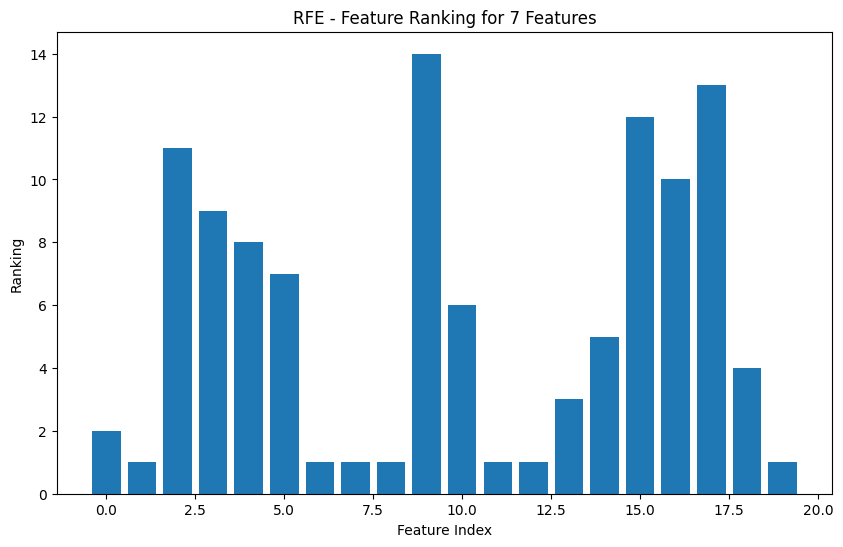

Selected 7 Features: [ 1  6  7  8 11 12 19]
Accuracy on the Test Set: 0.7210639025335176


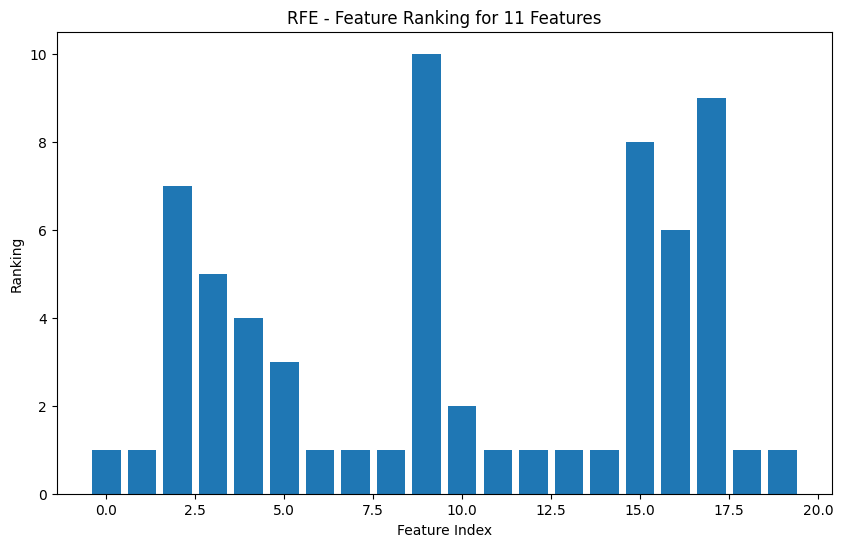

Selected 11 Features: [ 0  1  6  7  8 11 12 13 14 18 19]
Accuracy on the Test Set: 0.823161104940509


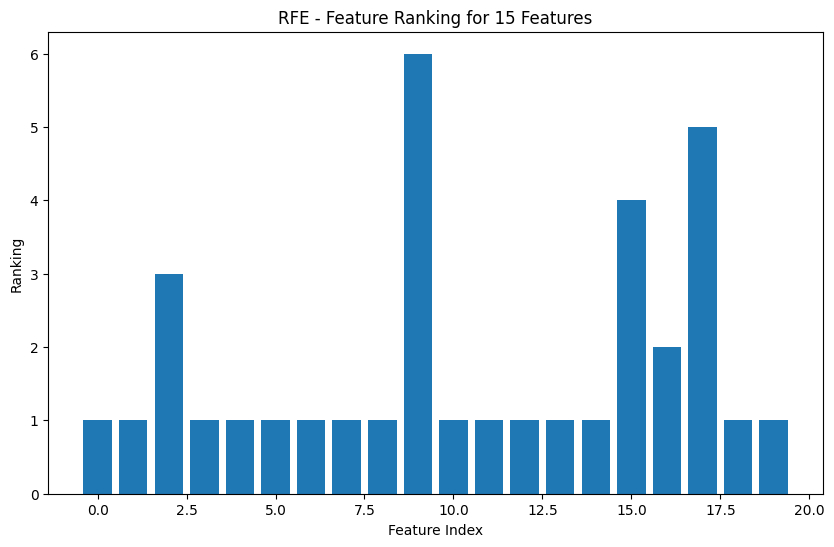

Selected 15 Features: [ 0  1  3  4  5  6  7  8 10 11 12 13 14 18 19]
Accuracy on the Test Set: 0.8215938823642154


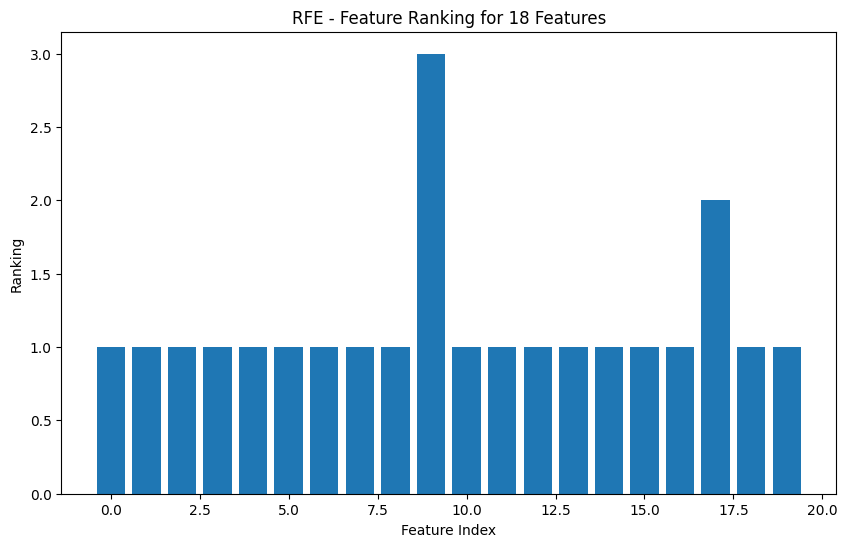

Selected 18 Features: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 18 19]
Accuracy on the Test Set: 0.8208102261876478


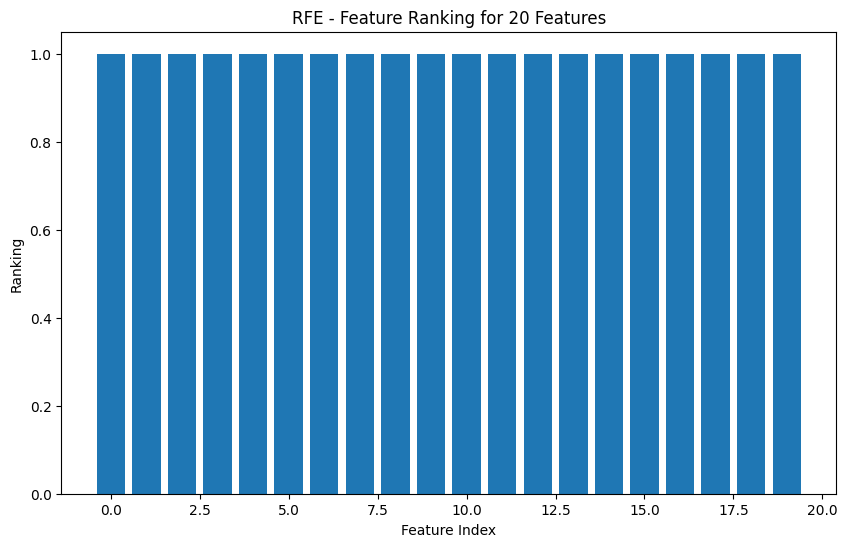

Selected 20 Features: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
Accuracy on the Test Set: 0.8209089543214738


In [59]:
from sklearn.feature_selection import RFE

# Split features and target variable
X = df.drop('Time_taken(min)', axis=1)  # Features
y = df['Time_taken(min)']  # Target variable

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaler = StandardScaler()                    # Create a StandardScaler object
scaler.fit(X_train)                          # Fit the scaler on the training data
X_train_scaled = scaler.transform(X_train)   # Perform standardization on the training data
X_test_scaled = scaler.transform(X_test)     # Perform standardization on the testing data

# Initialize XGBRegressor model as the base model
xgb_model = xgb.XGBRegressor(n_estimators=20, max_depth=9)

# Define the number of features to select
num_features_list = [7, 11, 15, 18, 20]

for num_features in num_features_list:

    # Initialize RFE with the model and the number of features to select
    rfe = RFE(estimator=xgb_model, n_features_to_select=num_features)

    # Fit RFE to the training data
    rfe.fit(X_train_scaled, y_train)

    # Get the ranking of each feature
    feature_ranking = rfe.ranking_

    # Get the selected features
    selected_features = np.where(feature_ranking == 1)[0]

    # Visualize the feature ranking
    plt.figure(figsize=(10, 6))
    plt.title(f"RFE - Feature Ranking for {num_features} Features")
    plt.xlabel("Feature Index")
    plt.ylabel("Ranking")
    plt.bar(range(len(feature_ranking)), feature_ranking)
    plt.show()

    # Print the selected features
    print(f"Selected {num_features} Features:", selected_features)

    # Train the final model using the selected features
    xgb_model.fit(X_train_scaled[:, selected_features], y_train)

    # Evaluate the model on the test set
    accuracy = xgb_model.score(X_test_scaled[:, selected_features], y_test)
    print("Accuracy on the Test Set:", accuracy)

For different sets of the number of selected features, the accuracy does not improve above 0.82. It is almost constant in both the feature selection techniques.

So, **XGB Regressor** with `n_estimators` = 20, `max_depth` = 9 is the **best model**.

# Conclusion

The food delivery prediction model was developed using XGBoost, achieving an impressive **R2 score** of **0.82**.

**An R2 score of 0.82 implies that the model can explain approximately 82% of the variance in the food delivery time based model.**

Moving forward, potential enhancements include identifying the best features, conducting additional feature engineering, and exploring other optimization techniques to further improve the model's performance and accuracy. These steps will contribute to fine-tuning the model and unlocking its full potential in predicting food delivery timings accurately.